<a href="https://colab.research.google.com/github/dhanushkasisil2700/UK_Used_Car_Analysis/blob/main/UK_Used_Car_Data_set_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Introduction: Understanding the Car Market**

The automotive industry is a complex ecosystem influenced by a multitude of factors. This project aims to delve into the intricacies of the car market by analyzing a comprehensive dataset. By examining various car attributes such as price, mileage, engine size, fuel type, transmission, and manufacturing year, we seek to uncover underlying patterns and trends.

Through data exploration and analysis, we will investigate how these factors correlate and influence car values. This project will provide valuable insights into the automotive market, aiding consumers, dealerships, and industry stakeholders in making informed decisions.

**Key objectives of this project include:**

* Identifying factors that significantly impact car prices.
* Understanding the relationship between car age, mileage, and value.
* Analyzing the impact of different car features (engine size, fuel type, transmission) on pricing.
* Identifying trends in the automotive market based on the analyzed data.

By accomplishing these objectives, this project aims to contribute to a deeper understanding of the car market dynamics.

**Install required Libraries**

In [191]:
pip install opendatasets plotly

**Import required libraries**

In [192]:
import opendatasets as od
import plotly.express as px
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

**Download Dataset**

In [193]:
import os
if not os.path.isdir("/content/used-car-dataset-ford-and-mercedes"):
    od.download("https://www.kaggle.com/datasets/adityadesai13/used-car-dataset-ford-and-mercedes", data_dir="./")
else:
    print("Dataset already downloaded")

Dataset already downloaded


**Import data into notebok**

In [194]:
raw_audi = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/audi.csv")
raw_bmw = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/bmw.csv")
raw_ford = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/ford.csv")
raw_hyundi = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/hyundi.csv")
raw_merc = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/merc.csv")
raw_skoda = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/skoda.csv")
raw_toyota = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/toyota.csv")
raw_vauxhall = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/vauxhall.csv")
raw_vw = pd.read_csv("/content/used-car-dataset-ford-and-mercedes/vw.csv")

**Making a one table using all datasets**

In [195]:
#add brand name into each dataset
raw_audi["brand"] = "audi"
raw_bmw["brand"] = "bmw"
raw_ford["brand"] = "ford"
raw_hyundi["brand"] = "hyundi"
raw_merc["brand"] = "merc"
raw_skoda["brand"] = "skoda"
raw_toyota["brand"] = "toyota"
raw_vauxhall["brand"] = "vauxhall"
raw_vw["brand"] = "vw"

In [196]:
#remake tax column in hyundi
raw_hyundi["tax"] = raw_hyundi["tax(£)"]
raw_hyundi.drop("tax(£)", axis=1, inplace=True)

In [197]:
#making one dataset using all datasets
df = pd.concat([raw_audi, raw_bmw, raw_ford, raw_hyundi, raw_merc, raw_skoda, raw_toyota, raw_vauxhall, raw_vw])

In [198]:
df

,model,year,price,transmission,mileage,fuelType,tax,mpg,engineSize,brand
0,A1,2017,12500,Manual,15735,Petrol,150,55.4,1.4,audi
1,A6,2016,16500,Automatic,36203,Diesel,20,64.2,2.0,audi
2,A1,2016,11000,Manual,29946,Petrol,30,55.4,1.4,audi
3,A4,2017,16800,Automatic,25952,Diesel,145,67.3,2.0,audi
4,A3,2019,17300,Manual,1998,Petrol,145,49.6,1.0,audi
...,...,...,...,...,...,...,...,...,...,...
15152,Eos,2012,5990,Manual,74000,Diesel,125,58.9,2.0,vw
15153,Fox,2008,1799,Manual,88102,Petrol,145,46.3,1.2,vw
15154,Fox,2009,1590,Manual,70000,Petrol,200,42.0,1.4,vw
15155,Fox,2006,1250,Manual,82704,Petrol,150,46.3,1.2,vw


In [199]:
ana_df = df.copy()

In [200]:
ana_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 99187 entries, 0 to 15156
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   model         99187 non-null  object 
 1   year          99187 non-null  int64  
 2   price         99187 non-null  int64  
 3   transmission  99187 non-null  object 
 4   mileage       99187 non-null  int64  
 5   fuelType      99187 non-null  object 
 6   tax           99187 non-null  int64  
 7   mpg           99187 non-null  float64
 8   engineSize    99187 non-null  float64
 9   brand         99187 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 8.3+ MB


# **`Explonatory Data Analysis`**

**Distribution of Brands**

In [201]:
px.bar(ana_df["brand"].value_counts(), title="Distribution of Brands", color=ana_df["brand"].value_counts().index)

This provided bar chart depicts the distribution of brands based on an unspecified value metric. The data reveals a significant disparity in brand performance, with 'Ford' leading the pack by a considerable margin. 'Vauxhall' and 'Merc' follow in the subsequent positions, showcasing a noticeable drop in value compared to the top performer. The remaining brands, 'BMW', 'Audi', 'Toyota', 'Skoda', and 'Hyundai', exhibit a relatively close range of values, suggesting a more competitive landscape within this group.

In [202]:
#value counts of models
brands = ana_df["brand"].value_counts().index

for brand in brands:
  print(f"{brand} : {ana_df[ana_df['brand'] == brand]['model'].value_counts()}")
  print("\n")

ford : model
 Fiesta                   6557
 Focus                    4588
 Kuga                     2225
 EcoSport                 1143
 C-MAX                     543
 Ka+                       531
 Mondeo                    526
 B-MAX                     355
 S-MAX                     296
 Grand C-MAX               247
 Galaxy                    228
 Edge                      208
 KA                        199
 Puma                       80
 Tourneo Custom             69
 Grand Tourneo Connect      59
 Mustang                    57
 Tourneo Connect            33
 Fusion                     16
 Streetka                    2
 Ranger                      1
 Escort                      1
 Transit Tourneo             1
Name: count, dtype: int64


vw : model
 Golf               4863
 Polo               3287
 Tiguan             1765
 Passat              915
 Up                  884
 T-Roc               733
 Touareg             363
 Touran              352
 T-Cross             300
 Golf SV  

**Distribution of models in each car brands**

In [203]:
for brand in brands:
  fig = px.bar(ana_df[ana_df["brand"] == brand]["model"].value_counts(),
               title=f"Distribution of {brand} Models",
               color=ana_df[ana_df["brand"] == brand]["model"].value_counts().index)
  fig.show()

These plots provides a snapshot of model popularity for several car brands. Ford and Volkswagen emerge as the dominant players, with a substantial lead in terms of overall model counts. Models like Ford Fiesta and Volkswagen Golf significantly contribute to their respective brand's dominance. While Vauxhall and Mercedes-Benz follow, their model diversity is somewhat narrower.

Brands like BMW, Audi, Toyota, Skoda, and Hyundai present a more balanced portfolio with multiple strong-selling models. However, none of these brands has a clear standout model dominating the market like Ford and Volkswagen.

It's important to note that this analysis is based solely on model counts and doesn't consider factors like market share, sales figures, or model age. A more comprehensive understanding would require additional data points.

**Distribution of years of car made**

In [204]:
ana_df["year"].value_counts()

,count
year,
2019,26771
2017,21733
2016,15850
2018,13664
2015,7645
2020,4465
2014,4085
2013,2603
2012,634


In [205]:
ana_df = ana_df[(ana_df["year"] <= 2020) & (ana_df["year"] > 1970)]

In [206]:
px.histogram(ana_df, x="year", title="Distribution of years of car made")

In [207]:
px.box(ana_df, y="year", title="Distribution of years of car made")

The box plot illustrates the distribution of car manufacturing years. The data indicates a concentration of cars produced in the mid-2010s, as evidenced by the box's central position. There's a noticeable presence of newer models (around 2020) and a significant number of older cars (before 2005), represented by the outliers. This suggests a diverse range of car ages in the dataset.

**Distribution of made years with brands**

In [208]:
px.box(ana_df, x="brand", y="year", title="Distribution of made years with brands", color="brand")

The box plot visualizes the distribution of car manufacturing years across different brands. We observe that most cars across all brands were manufactured between 2010 and 2015. However, there's a noticeable presence of newer models (around 2020) and a significant number of older cars (before 2005), represented by outliers, particularly for brands like Audi and BMW. This suggests a diverse range of car ages across the brands, with some offering a wider range of model years than others.

**Distribution of price**

In [209]:
px.histogram(ana_df, x="price", title="Distribution of price", nbins=400)

The distribution of prices is heavily skewed to the right, indicating a large number of lower-priced items and a smaller number of significantly higher-priced ones. The majority of prices fall within the 0-40k range, with a rapid decline in frequency as the price increases. This suggests a market with a mix of budget-friendly and luxury products.

In [210]:
px.box(ana_df, y="price", title="Distribution of price")

The distribution of prices exhibits a significant number of outliers, indicating a wide range of values. The majority of prices fall within the 20k to 40k range, as suggested by the box and median line. However, there is a substantial number of prices concentrated between 40k and 100k, as indicated by the whisker extending to 100k. Additionally, numerous outliers extend beyond 100k, suggesting the presence of significantly higher-priced items. This distribution suggests a market with a mix of affordable and premium products.

In [211]:
px.box(ana_df, x="brand", y="price", title="Distribution of price with brands", color="brand")

The box plot illustrates the distribution of car prices across different brands. There's a significant price range among the brands, with Audi and BMW exhibiting the highest median prices and a wider spread of values. On the other hand, brands like Hyundai, Skoda, and Vauxhall tend to have lower median prices and a narrower price range. The presence of outliers across all brands indicates the existence of both premium and budget models within each brand. This suggests that while some brands cater primarily to the luxury segment, others focus on offering more affordable options.

In [212]:
px.histogram(ana_df, x="price", title="Distribution of price with brands", color="brand", nbins=400)

The distribution of car prices reveals a significant overlap among brands, particularly in the lower price ranges. Audi, BMW, and Mercedes-Benz have a higher concentration of vehicles in the premium price segments, while brands like Hyundai, Skoda, and Vauxhall primarily cater to the budget-conscious market. However, it's important to note that there are exceptions within each brand, with some offering both affordable and luxury models.

In [213]:
fig = px.scatter(ana_df, x="year", y="price", title="Distribution of price with years")
fig.show()

The scatter plot illustrates the relationship between car prices and their manufacturing year. There is a general upward trend indicating that newer cars tend to have higher prices. However, there's significant variation within each year, suggesting factors beyond the year of manufacture influence the price. The presence of outliers, especially higher-priced cars in earlier years, indicates that other variables like model, brand, or condition play a crucial role in determining price.

In [214]:
#correlation between price and year
ana_df[["price", "year"]].corr()

,price,year
price,1.000000,0.494571
year,0.494571,1.000000


The correlation coefficient between car price and manufacturing year is 0.494571 . This indicates a moderate positive correlation. While newer cars tend to be more expensive on average, there is a significant influence from other factors like model, brand, and condition.

In [215]:
px.scatter(ana_df, x="price", y="tax", title="Scatterplot between price and tax")

The scatter plot illustrates a weak relationship between price and tax. While there is some dispersion of tax values across different price points, the data points form a dense horizontal band, suggesting that tax is relatively consistent regardless of price. This indicates that tax is likely determined by factors other than the product's price.

In [216]:
px.box(ana_df, x="transmission", y="price", title="Distribution with price with transmission", color="transmission")

The box plot illustrates a clear correlation between transmission type and car price. Automatic and Semi-Auto transmissions are associated with significantly higher price points compared to Manual and Other transmission types. There is a substantial overlap in price ranges among Automatic and Semi-Auto, while Manual and Other transmissions exhibit a more concentrated distribution at lower price points. This suggests that transmission type is a key factor influencing vehicle pricing.

In [217]:
#distribution with price and milage
px.scatter(ana_df, x="price", y="mileage", title="Scatterplot between price and mileage", color="transmission")

The scatter plot reveals a strong negative correlation between price and mileage. As the mileage of a car increases, its price generally decreases. This is evident in the downward trend of the data points. However, there is considerable overlap between the different transmission types, suggesting that while mileage is a significant factor in determining price, other variables like car make, model, and condition also play a role.

In [218]:
ana_df[["price", "mileage"]].corr()

,price,mileage
price,1.000000,-0.417941
mileage,-0.417941,1.000000


The correlation coefficient of -0.417941 between price and mileage indicates a moderate negative relationship. This suggests that as a car's mileage increases, its price tends to decrease. However, it's important to note that other factors such as car make, model, and condition also influence the price.

In [219]:
px.box(ana_df, x="fuelType", y="price", title="Distribution with price with fuelType", color="fuelType")

The box plot illustrates a strong correlation between fuel type and car price. Electric and Hybrid vehicles tend to have significantly higher price points compared to Petrol, Diesel, and Other fuel types. There is a substantial overlap between Petrol and Diesel prices, while Other and Electric categories show more variability. These findings suggest that the type of fuel significantly influences a car's overall cost.

In [220]:
px.bar(ana_df["fuelType"].value_counts(), title="Distribution of fuelType", color=ana_df["fuelType"].value_counts().index)

The bar chart illustrates the distribution of fuel types. Petrol and Diesel vehicles dominate the market, accounting for a significantly larger proportion compared to Hybrid, Other, and Electric vehicles. The latter three categories represent a much smaller percentage of the overall distribution. This suggests a strong preference for traditional fuel types, with a growing but still relatively small market for alternative fuel options.

In [221]:
px.bar(ana_df['engineSize'].value_counts(), title="Distribution of engineSize", color=ana_df['engineSize'].value_counts().index)

The distribution of engine sizes is heavily skewed towards smaller engines, with a significant concentration between 1 and 2 liters. There are fewer vehicles with larger engines, and extremely large engines are quite rare. This distribution suggests a market preference for fuel efficiency and potentially lower emissions.

In [222]:
#distribution with engine size
px.scatter(ana_df, x="price", y="engineSize", title="Scatterplot between price and engineSize", color="transmission")

The scatter plot illustrates a complex relationship between price and engine size. There is a general trend towards higher prices with larger engine sizes, particularly evident in the Automatic and Semi-Auto transmission groups. However, there's significant overlap among all transmission types, suggesting that engine size is not the sole determinant of price. Other factors such as brand, model, features, and condition likely influence the price variation.

In [223]:
ana_df[["price", "engineSize"]].corr()

,price,engineSize
price,1.000000,0.638168
engineSize,0.638168,1.000000


A correlation coefficient of 0.638168 between price and engine size indicates a moderate positive relationship. This suggests that as engine size increases, there is a tendency for car prices to also increase. However, it's important to note that other factors such as car make, model, and features also contribute to price variation.

In [224]:
px.histogram(ana_df, x="mpg", title="Distribution of mpg")

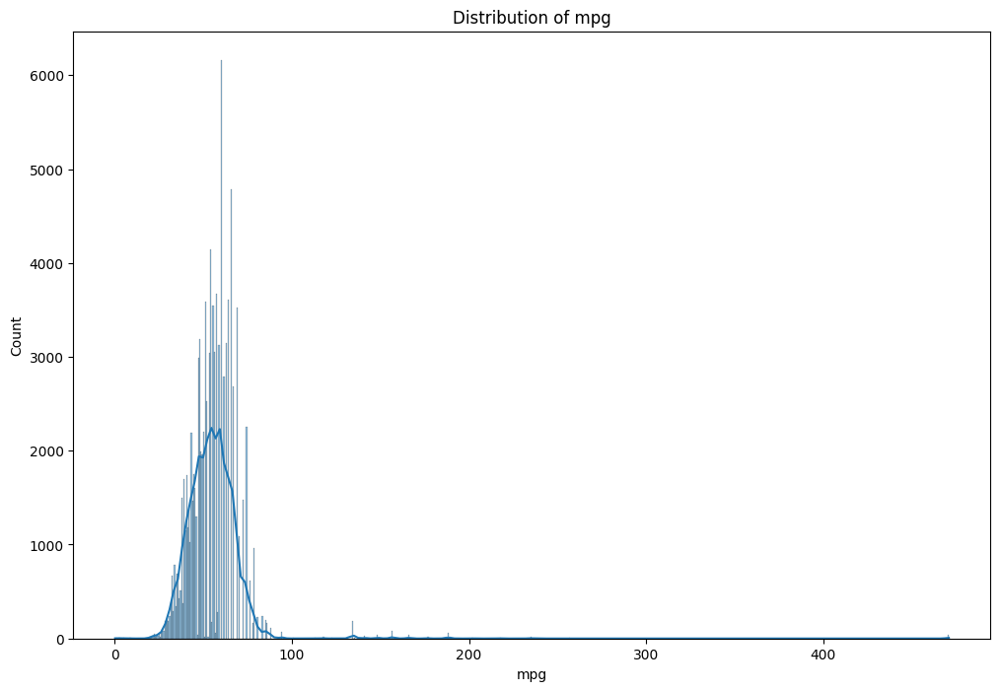

In [225]:
plt.figure(figsize=(12, 8))
sns.histplot(ana_df["mpg"], kde=True)
plt.title("Distribution of mpg")
plt.show()

The distribution of MPG is heavily skewed towards lower values, with a significant concentration between 0 and 100 mpg. There are fewer vehicles with higher MPG ratings, and extremely high MPG values are quite rare. This suggests that the majority of vehicles in the dataset have relatively low fuel efficiency.

In [226]:
px.scatter(ana_df, x="price", y="mpg", title="Scatterplot between price and mpg", color="transmission")

The scatter plot illustrates a strong negative correlation between price and MPG, suggesting that as the price of a car increases, its fuel efficiency tends to decrease. However, there is considerable overlap between the different transmission types, indicating that while MPG is a significant factor influencing price, other variables like car make, model, and engine size also play a role.

In [227]:
transmissions = ana_df["transmission"].value_counts().index
for transmission in transmissions:
  fig = px.scatter(ana_df[ana_df["transmission"] == transmission],
             x="price", y="mpg",
             title=f"Scatterplot between price and mpg with {transmission} transmission",
             color="transmission")
  fig.update_layout(xaxis_title="Price", yaxis_title="MPG")
  fig.show()

The scatter plot illustrates a strong negative correlation between price and mpg for cars with manual transmission, suggesting that as the price of a car increases, its fuel efficiency tends to decrease. However, there is considerable overlap within the data points, indicating that while mpg is a significant factor influencing price, other variables like car make, model, and engine size also play a role.

In [228]:
#distribution of millage
px.histogram(ana_df, x="mileage", title="Distribution of mileage")

The distribution of mileage is heavily skewed to the right, indicating a large number of vehicles with lower mileage and a smaller number with significantly higher mileage. The majority of vehicles have mileage under 100,000 miles, with a rapid decline in frequency as mileage increases. This suggests a market with a mix of vehicles with relatively low usage and a smaller proportion of vehicles with high mileage.

In [229]:
#distribution of millage
px.histogram(ana_df, x="mileage", title="Distribution of mileage", color="year")

The provided plot visualizes the distribution of mileage across different car production years. The data reveals that:

**Newer cars generally have lower mileage:** Cars produced in recent years (2015-2023) tend to have significantly lower mileage compared to older cars.

**Mileage increases with car age:** As the production year gets older, the distribution of mileage shifts towards higher values, indicating that cars accumulate more miles over time.

**Outliers:** There are some outliers representing cars with exceptionally high mileage for their production year, which could be due to various factors like usage patterns or vehicle type.

**Distribution shape:** The distribution of mileage within each year is right-skewed, meaning most cars have relatively low mileage, with a smaller number having significantly higher mileage.

Overall, the plot suggests a clear relationship between car age and mileage, with newer cars typically having lower mileage compared to older cars.

In [230]:
px.histogram(ana_df, x="tax", title="Distribution of tax")

The distribution of tax is heavily skewed to the left, indicating a large number of lower tax values and a smaller number of significantly higher tax values. The majority of tax values fall within the 0-100 range, with a rapid decline in frequency as the tax value increases. This suggests a market with a mix of low-tax and high-tax products.

In [231]:
px.box(ana_df, y="tax", title="Distribution of tax")

The distribution of tax shows a wide range of values, with a significant number of outliers, indicating a wide range of values. The majority of taxes fall within the 100-200 range, as suggested by the box and median line. However, there is a substantial number of taxes concentrated between 200 and 600, as indicated by the whisker extending to 600. Additionally, numerous outliers extend beyond 600, suggesting the presence of significantly higher-priced items. This distribution suggests a market with a mix of low and high-tax products.

In [232]:
px.box(ana_df, x="brand", y="tax", title="Distribution of tax with brands", color="brand")

The box plot illustrates the distribution of tax values across different car brands. There's a significant variation in tax amounts among the brands, with Audi and BMW exhibiting the highest median tax values and a wider spread of values. On the other hand, brands like Ford, Hyundai, and Skoda tend to have lower median tax values and a narrower tax range. The presence of outliers across all brands indicates the existence of both high and low-tax vehicles within each brand. This suggests that while some brands have a higher tax burden overall, there are variations within each brand as well.

Key observations:

**Tax variation:** There is a considerable difference in tax values among brands.
**Outliers:** Some brands have a higher proportion of vehicles with exceptionally high taxes.
**Brand diversity:** Each brand offers a mix of low and high-tax vehicles.

In [233]:
px.scatter(ana_df, x="tax", y="year", title="Distribution of tax with price")

The scatter plot illustrates the distribution of tax values across different car production years. The data reveals that:

**Newer cars generally have higher tax values:** Cars produced in recent years (2015-2023) tend to have significantly higher tax values compared to older cars.

**Tax values increase with car age:** As the production year gets older, the distribution of tax values shifts towards lower values, indicating that cars have lower tax values over time.

**Outliers:** There are some outliers representing cars with exceptionally low tax values for their production year, which could be due to various factors like vehicle type or tax exemptions.

**Distribution shape:** The distribution of tax values within each year is relatively uniform, meaning cars have a wide range of tax values within each production year.

Overall, the plot suggests a clear relationship between car age and tax value, with newer cars typically having higher tax values compared to older cars.

In [234]:
px.scatter(ana_df, x="price", y="year", title="Distribution of price with year with tax", size="tax", color="transmission")

The scatter plot illustrates the relationship between car price, year of manufacture, and transmission type. Several key trends emerge:

Newer cars tend to be more expensive: There's a general upward trend in car prices as the year of manufacture increases, suggesting inflation and technological advancements as potential factors.
Transmission type influences price: Automatic and Semi-Auto transmissions are associated with higher price points compared to Manual and Other transmissions, indicating a premium for these transmission types.
Price variation within years: There is significant price variation within each year, suggesting factors beyond the year of manufacture and transmission type, such as brand, model, and condition, influence the price.
Overall, the plot suggests a complex interplay between these variables in determining car prices. Further analysis could delve deeper into specific car models, brands, or additional factors to gain a more nuanced understanding of the price dynamics.

In [235]:
#price distribution with audi model
px.histogram(ana_df[ana_df["brand"] == "audi"], x="price", title="Distribution of price with audi model", color="model")

In [236]:
px.box(ana_df[ana_df["brand"] == "audi"], x="model", y="price", title="Distribution of price with audi model", color="model")

The box plot illustrates a clear variation in price across different Audi models. Models like A8, S8, and RS models command significantly higher price points compared to models like A1, A3, and Q2. There's a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that Audi offers a range of price points to cater to different customer segments.

In [237]:
brands

Index(['ford', 'vw', 'vauxhall', 'merc', 'bmw', 'audi', 'toyota', 'skoda',
       'hyundi'],
      dtype='object', name='brand')

In [238]:
px.box(ana_df[ana_df["brand"] == "ford"], x="model", y="price", title="Distribution of price with ford model", color="model")

The box plot illustrates a significant price variation among different Ford models. Models like Fiesta, Focus, and Puma tend to be more affordable, with a lower median price and a narrower price range. On the other hand, models like Kuga, Mondeo, and S-MAX fall into a higher price bracket, with a wider distribution of prices. The presence of outliers across multiple models indicates the existence of both premium and budget variants within specific model lines. Overall, the plot suggests that Ford offers a diverse range of price points to cater to different customer preferences and budgets.

In [239]:
px.box(ana_df[ana_df["brand"] == "hyundi"], x="model", y="price", title="Distribution of price with hyundi model", color="model")

The box plot illustrates a significant price variation among different Hyundai models. Models like Tucson, Santa Fe, and Kona command significantly higher price points compared to models like Accent, Getz, and Amica. There is a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that Hyundai offers a diverse range of price points to cater to different customer preferences and budgets.

In [240]:
px.box(ana_df[ana_df["brand"] == "merc"], x="model", y="price", title="Distribution of price with merc model", color="model")

The box plot illustrates a significant price variation among different Mercedes-Benz models. Models like S Class, SL CLASS, and G Class command significantly higher price points compared to models like A Class, B Class, and CLA Class. There is a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that Mercedes-Benz offers a diverse range of price points to cater to different customer preferences and budgets.

In [241]:
px.box(ana_df[ana_df["brand"] == "skoda"], x="model", y="price", title="Distribution of price with skoda model", color="model")

The box plot illustrates a significant price variation among different Skoda models. Models like Superb, Kodiaq, and Octavia command significantly higher price points compared to models like Citigo, Fabia, and Kamiq. There is a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that Skoda offers a diverse range of price points to cater to different customer preferences and budgets.

In [242]:
px.box(ana_df[ana_df["brand"] == "toyota"], x="model", y="price", title="Distribution of price with toyota model", color="model")

The box plot illustrates a significant price variation among different Toyota models. Models like GT86, RAV4, and Land Cruiser command significantly higher price points compared to models like Aygo, Yaris, and Verso-S. There is a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that Toyota offers a diverse range of price points to cater to different customer preferences and budgets.

In [243]:
px.box(ana_df[ana_df["brand"] == "vauxhall"], x="model", y="price", title="Distribution of price with vauxhall model", color="model")

The box plot illustrates a significant price variation among different Vauxhall models. Models like Insignia and Astra tend to have higher median prices and a wider price range, indicating a premium segment. On the other hand, models like Corsa, Viva, and Adam fall into a lower price bracket with a narrower price distribution. The presence of outliers across multiple models suggests the existence of both high-end and budget variants within specific model lines. Overall, the plot suggests that Vauxhall offers a diverse range of price points to cater to different customer preferences and budgets.

In [244]:
px.box(ana_df[ana_df["brand"] == "vw"], x="model", y="price", title="Distribution of price with vw model", color="model")

The box plot illustrates a significant price variation among different VW models. Models like Touareg, Arteon, and Tiguan command significantly higher price points compared to models like Up, Polo, and Fox. There is a substantial overlap in price ranges among certain models, indicating some price variation within specific model lines. The presence of outliers for some models suggests the existence of particularly high-priced or low-priced variants. Overall, the plot suggests that VW offers a diverse range of price points to cater to different customer preferences and budgets.

# **Conclution**

This analysis of car data has revealed several key insights regarding various factors that influence car prices, fuel efficiency, and other characteristics. Here are some of the key findings:




*   A moderate positive correlation exists between price and year of manufacture, indicating newer cars tend to be more expensive.
*   Transmission type significantly impacts price, with Automatic and Semi-Automatic transmissions commanding higher premiums.
*   Engine size has a moderate positive correlation with price, but other factors like brand and model also play a role.
*   A moderate negative correlation exists between price and MPG, suggesting that as the price of a car increases, its fuel efficiency tends to decrease.
*   Engine size is inversely proportional to fuel efficiency, with larger engines generally resulting in lower MPG.
*   There is a significant variation in tax values across different car brands and production years.
*   The distribution of mileage shows a mix of vehicles with relatively low usage and a smaller proportion with high mileage.
*   Different car brands offer a diverse range of price points to cater to various customer segments.

Overall, this analysis highlights the complex interplay between various factors that influence car buying decisions. By considering these factors, potential car buyers can make more informed choices based on their budget, needs, and preferences.